# import libraries

In [1]:
import pandas as pd
import numpy as np

# Read Data
    - data contain about 16.000 posts from facebook 
    - data in arabic language

In [9]:
sentences=pd.read_csv("data_lda.csv",sep="&",names=["data"]).dropna()

In [10]:
sentences

,data
0,#السورية للمخابز تتحدّث عن #آلية جديدة لبيع #ا...
1,#النقل خلال الاجتماع السنوي #لغرفة الملاحة الب...
2,#فرّح أهلك : خدمة في #مصر تساعد السوريين على ت...
3,#قسد تطالب بتعاون دولي لمحاكمة أسرى داعـش :
4,#نيويورك تايمز نقلا عن مسؤول #أمريكي: إسرائيل ...
...,...
16780,لكنني والله لستُ سيئة ليُصيبُني كُل هذا الحُزن...
16781,لن يكون الرئيس بشار من يحني رأسه ورأس شعبه لأح...
16782,لن يكون الرئيس بشار من يحني رأسه ورأس شعبه لأح...
16783,لو أنّ كل إنسان فعل ما بوسعه لتجميل رقعة الأرض...


In [11]:
loadedSentsCount = len(sentences)
print(">> %d sentences loaded .." % loadedSentsCount)

>> 16785 sentences loaded ..


# prepare data for word2vec model
    - split every sentence into words

In [15]:
sentences_for_model=sentences['data'].apply(str.split)

In [16]:
sentences_for_model

0        [#السورية, للمخابز, تتحدّث, عن, #آلية, جديدة, ...
1        [#النقل, خلال, الاجتماع, السنوي, #لغرفة, الملا...
2        [#فرّح, أهلك, :, خدمة, في, #مصر, تساعد, السوري...
3        [#قسد, تطالب, بتعاون, دولي, لمحاكمة, أسرى, داع...
4        [#نيويورك, تايمز, نقلا, عن, مسؤول, #أمريكي:, إ...
                               ...                        
16780    [لكنني, والله, لستُ, سيئة, ليُصيبُني, كُل, هذا...
16781    [لن, يكون, الرئيس, بشار, من, يحني, رأسه, ورأس,...
16782    [لن, يكون, الرئيس, بشار, من, يحني, رأسه, ورأس,...
16783    [لو, أنّ, كل, إنسان, فعل, ما, بوسعه, لتجميل, ر...
16784    [لورانس, ريبل, عجوز, عمره, سنة, بعد, مرور, سنة...
Name: data, Length: 16785, dtype: object

# Build word2vec model
    - initiate and fit word2vec model on our data

In [ ]:
from gensim.models import Word2Vec
word2VecModel = Word2Vec(sentences_for_model, 
                 min_count=2,   # Ignore words that appear less than this
                 size=150,      # Dimensionality of word embeddings
                 workers=8,     # Number of processors (parallelisation)         
                 window=5,      # Context window for words during training
                 iter=1000)       # Number of epochs training over corpus
print(len(word2VecModel.wv.vocab))

In [51]:
# import fasttext
# # model = fasttext.train_supervised(input = 'Terrorist DS.train.txt')
# ft_model = fasttext.train_unsupervised('all_data_Category.csv', model='skipgram',epoch=100,dim=150,thread=5)

In [52]:
# len(ft_model.get_words())

In [53]:
# ft_model.save_model('ft_model_JeelWithoutEmotionsWithE.bin')

In [7]:
word2VecModel.wv.vocab

{'#': <gensim.models.keyedvectors.Vocab at 0x2a056931e88>,
 'ا': <gensim.models.keyedvectors.Vocab at 0x2a056931ec8>,
 'ل': <gensim.models.keyedvectors.Vocab at 0x2a056931f88>,
 'س': <gensim.models.keyedvectors.Vocab at 0x2a056931f08>,
 'و': <gensim.models.keyedvectors.Vocab at 0x2a056948048>,
 'ر': <gensim.models.keyedvectors.Vocab at 0x2a0569480c8>,
 'ي': <gensim.models.keyedvectors.Vocab at 0x2a056948108>,
 'ة': <gensim.models.keyedvectors.Vocab at 0x2a056948148>,
 ' ': <gensim.models.keyedvectors.Vocab at 0x2a056931fc8>,
 'م': <gensim.models.keyedvectors.Vocab at 0x2a056948088>,
 'خ': <gensim.models.keyedvectors.Vocab at 0x2a056948188>,
 'ب': <gensim.models.keyedvectors.Vocab at 0x2a0569481c8>,
 'ز': <gensim.models.keyedvectors.Vocab at 0x2a056948208>,
 'ت': <gensim.models.keyedvectors.Vocab at 0x2a056948248>,
 'ح': <gensim.models.keyedvectors.Vocab at 0x2a056948288>,
 'د': <gensim.models.keyedvectors.Vocab at 0x2a0569482c8>,
 'ّ': <gensim.models.keyedvectors.Vocab at 0x2a056948308

In [55]:
def computeVectorsFromRaw(RawNPs, model, repLen = 150):
    import numpy as np
    # repLen word representation vector length
    VectorizedNPs = []
    for Np in RawNPs:
        vec = np.zeros(repLen)
        words = Np.split()
        Vecs = [model.wv.get_vector(word) for word in words if len(word) >= 3 and word in model.wv.vocab]
        if len(Vecs)>0:
            vec = np.sum(Vecs,axis=0)
        VectorizedNPs.append((Np, vec))
    return VectorizedNPs

In [57]:
loadedSents = pd.read_csv("data_lda.csv",sep="&",names=["data"]).dropna().values.flatten().tolist()


In [58]:
VectorizedNPs = computeVectorsFromRaw(loadedSents, word2VecModel)

In [59]:
import pandas as pd
VectorizedDf = pd.DataFrame(VectorizedNPs,columns=['NP','Vector'])
# (VectorizedDf['Vector'][22])
print(len(VectorizedDf['Vector']))
VectorizedDf

16785


,NP,Vector
0,#السورية للمخابز تتحدّث عن #آلية جديدة لبيع #ا...,"[11.807104, -22.454023, 25.142353, -21.77962, ..."
1,#النقل خلال الاجتماع السنوي #لغرفة الملاحة الب...,"[-1.7399317, -58.600132, 9.786593, -35.656776,..."
2,#فرّح أهلك : خدمة في #مصر تساعد السوريين على ت...,"[9.797212, 0.7179087, -9.407389, -0.16543913, ..."
3,#قسد تطالب بتعاون دولي لمحاكمة أسرى داعـش :,"[4.58392, 0.39817357, -8.730441, 3.0802255, 17..."
4,#نيويورك تايمز نقلا عن مسؤول #أمريكي: إسرائيل ...,"[2.3954618, -4.6693573, -13.320957, -11.724831..."
...,...,...
16780,لكنني والله لستُ سيئة ليُصيبُني كُل هذا الحُزن...,"[5.995217, -2.667667, 11.001847, -1.5391548, -..."
16781,لن يكون الرئيس بشار من يحني رأسه ورأس شعبه لأح...,"[6.197804, 23.853033, 0.9424522, -47.022255, 2..."
16782,لن يكون الرئيس بشار من يحني رأسه ورأس شعبه لأح...,"[21.403059, 10.796695, 15.813204, -25.544214, ..."
16783,لو أنّ كل إنسان فعل ما بوسعه لتجميل رقعة الأرض...,"[16.08582, 8.267838, -13.36803, 7.0398235, 8.9..."


In [63]:
from sklearn.manifold import TSNE
import numpy as np

result_tsne=TSNE().fit_transform(XFinal)

In [64]:
from sklearn.cluster import MiniBatchKMeans

In [65]:
tsne_df = pd.DataFrame(result_tsne, columns=['x', 'y'])

In [66]:
cls = MiniBatchKMeans(n_clusters=10, random_state=1000)
cl=cls.fit_predict(result)

In [67]:
tsne_df['cluster']=cl

In [68]:
d=dict(tsne_df['cluster'].value_counts())

In [69]:
def a(cluster):
    return str(d[cluster])

In [70]:
tsne_df['number_cluster']=tsne_df['cluster'].apply(a)

In [71]:
import seaborn as sns 

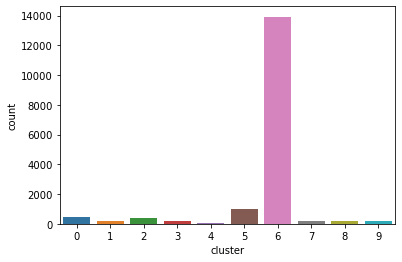

In [72]:
sns.countplot(x='cluster',data=tsne_df)

In [73]:
tsne_df['cluster']=tsne_df['cluster'].apply(str)

In [75]:
tsne_df['words']=VectorizedDf['NP']

In [76]:
import bokeh.plotting as bp
from  bokeh.palettes import d3
from bokeh.models import mappers as bmo
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, BoxSelectTool

output_notebook()
plot_tfidf = bp.figure(plot_width=1000, plot_height=1000, title="A map of word vectors",
    tools="pan,wheel_zoom,box_zoom,reset,hover",
    x_axis_type=None, y_axis_type=None, min_border=1)

Loading BokehJS ...

In [77]:
palette = d3['Category10'][len(tsne_df['cluster'].unique())]
color_map = bmo.CategoricalColorMapper(factors=tsne_df['cluster'].unique(),
                                   palette=palette)
plot_tfidf.scatter(x='x', y='y', source=tsne_df,color={'field': 'cluster','transform': color_map})
hover = plot_tfidf.select(dict(type=HoverTool))
hover.tooltips={"count": "@number_cluster","post":"@words","cluster":"@cluster"}
show(plot_tfidf)

In [61]:
VectorizedDf['Vector'].values.shape

(16785,)

In [60]:
result=[]
for r in VectorizedDf['Vector'].values:  
    result.append(list(r))

In [53]:
# VectorizedNPs

In [62]:
import pandas as pd
VectorizedDf = pd.DataFrame(VectorizedNPs,columns=['NP','Vector'])
# (VectorizedDf['Vector'][22])
print(len(VectorizedDf['Vector']))
import numpy as np
countZeros = 0
zerosIdx = []
testDf = VectorizedDf
for i in range(len(VectorizedDf['Vector'])):
    if (type(VectorizedDf['Vector'][i]) != np.ndarray):
        zerosIdx.append(i)
VectorizedDf = VectorizedDf.drop(VectorizedDf.index[[zerosIdx]])
print(len(VectorizedDf))
# X = pd.DataFrame.as_matrix(VectorizedDf['Vector'])
X=VectorizedDf['Vector'].values
XFinal = np.zeros(shape=(len(VectorizedDf),word2VecModel.vector_size))
for i in range(len(VectorizedDf['Vector'])):
    XFinal[i] = X[i]
print(XFinal.shape)

16785
16785
(16785, 150)


C:\Users\khaled.15\AppData\Roaming\Python\Python37\site-packages\pandas\core\indexes\base.py:4307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  result = getitem(key)


In [61]:
import time
from sklearn.cluster import KMeans
start_time = time.time()
km = KMeans(n_clusters = 2,
           init = 'k-means++',
           n_init = 10,
           max_iter = 20000,
           random_state = 0)
km.fit(XFinal)
end_time = time.time()
print("Time to Run in seconds:  ", end_time-start_time)

Time to Run in seconds:   2.003999948501587


In [63]:
from sklearn.cluster import SpectralClustering
cl = SpectralClustering(n_clusters=10, affinity='nearest_neighbors',n_neighbors=25).fit_predict(XFinal)

c:\programdata\anaconda3\lib\site-packages\sklearn\manifold\_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


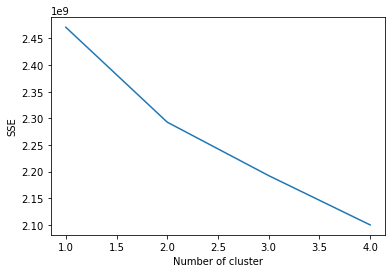

In [64]:
import pandas as pd
from sklearn.datasets import load_iris
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# iris = load_iris()
# X = pd.DataFrame(iris.data, columns=iris['feature_names'])
# #print(X)
# data = X[['sepal length (cm)', 'sepal width (cm)', 'petal length (cm)']]

sse = {}
for k in range(1, 5):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(XFinal)
#     data["clusters"] = kmeans.labels_
    #print(data["clusters"])
    sse[k] = kmeans.inertia_ # Inertia: Sum of distances of samples to their closest cluster center
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")

plt.ylabel("SSE")
plt.show()

In [65]:
import pandas as pd
cluster_map = pd.DataFrame()
cluster_map['data_index'] = VectorizedDf['Vector'].index.values
cluster_map['cluster'] = cl
# cluster_map

In [66]:
len( km.labels_)

16749

In [67]:
clusters = {}
for i in range(0,km.n_clusters):
    clusters["cluster{0}".format(i)]=cluster_map[cluster_map.cluster == i]['data_index']

In [68]:
clustersValues ={}
child1 = []
for i in range(0,len(clusters.keys())):
    temp = pd.DataFrame(clusters["cluster{0}".format(i)])
    clustersValues["clustersValues{0}".format(i)] = pd.DataFrame(VectorizedDf.loc[temp['data_index']]['Vector'])
    
    shapedArray = np.zeros(shape=(len(clustersValues["clustersValues{0}".format(i)]),word2VecModel.vector_size))
#     temp = pd.DataFrame.as_matrix(clustersValues["clustersValues{0}".format(i)]['Vector'])
    temp = clustersValues["clustersValues{0}".format(i)]['Vector'].values

    for j in range(len(clustersValues["clustersValues{0}".format(i)]['Vector'])):
        shapedArray[j] = temp[j]
    child1.append(shapedArray)
child1=np.concatenate((child1),axis=0)    

In [69]:
# print(len(clustersValues['clustersValues0']))
# test = VectorizedDf.loc[clustersValues['clustersValues3']['Vector'].index.values,:]
# test["cluster"]="clustersValues3"
# test

In [70]:
def concateanate_all_data_with_cluser(VectorizedDf,clustersValues):
    res=pd.DataFrame()
    for item in list(clustersValues.keys()):
        test = VectorizedDf.loc[clustersValues[item]['Vector'].index.values,:]
        test["cluster"]=item
        res=pd.concat([res,test])
    return res
        
new_data=concateanate_all_data_with_cluser(VectorizedDf,clustersValues)


In [71]:
from sklearn.decomposition import PCA
def pcaReduction(data,n_components_desired):
    import pandas as pd
    pca = PCA(n_components=n_components_desired,
         random_state = 123,
         svd_solver = 'auto'
         )

    df_pca = pd.DataFrame(pca.fit_transform(data))
    return df_pca,pca

def amountOfVariancePCA(pca):
    #The amount of variance that each PC explains
    var= pca.explained_variance_ratio_

In [76]:
def pcaVisualization(level,VectorizedDf):
#     importingLibrary()
    word_vectors = list(VectorizedDf["Vector"].values)
    # dimensionality reduction. converting the vectors to 2d vectors
    from sklearn.manifold import TSNE
    import bokeh.models as bmo
    from bokeh.palettes import d3
    tsne_model = TSNE(n_components=2, verbose=1, random_state=0)
    tsne_w2v = tsne_model.fit_transform(word_vectors)
    
    
    # putting everything in a dataframe
    tsne_df = pd.DataFrame(tsne_w2v, columns=['x', 'y'])
    c = 'clustersValues'+str(level)
    tsne_df['words'] = list(VectorizedDf['NP'])
    tsne_df["cluster"]=list(VectorizedDf['cluster'])
    # plotting. the corresponding word appears when you hover on the data point.
    palette = d3['Category10'][10]
    color_map = bmo.CategoricalColorMapper(factors=tsne_df['cluster'].unique(),palette=palette)
    plot_tfidf.scatter(x='x', y='y', source=tsne_df,color={'field': 'cluster','transform': color_map})
    hover = plot_tfidf.select(dict(type=HoverTool))
    hover.tooltips={"word": "@words"}
    show(plot_tfidf)
    return tsne_w2v

In [81]:
cluster_map.cluster.value_counts()

0    16060
8      337
7      111
2       57
9       42
3       35
6       28
1       27
5       27
4       25
Name: cluster, dtype: int64

In [78]:
import bokeh.plotting as bp
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, BoxSelectTool

output_notebook()
plot_tfidf = bp.figure(plot_width=500, plot_height=400, title="A map of word vectors",
    tools="pan,wheel_zoom,box_zoom,reset,hover",
    x_axis_type=None, y_axis_type=None, min_border=1)

Loading BokehJS ...

In [79]:
tsne=pcaVisualization(0,new_data)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 16087 samples in 0.837s...
[t-SNE] Computed neighbors for 16087 samples in 110.324s...
[t-SNE] Computed conditional probabilities for sample 1000 / 16087
[t-SNE] Computed conditional probabilities for sample 2000 / 16087
[t-SNE] Computed conditional probabilities for sample 3000 / 16087
[t-SNE] Computed conditional probabilities for sample 4000 / 16087
[t-SNE] Computed conditional probabilities for sample 5000 / 16087
[t-SNE] Computed conditional probabilities for sample 6000 / 16087
[t-SNE] Computed conditional probabilities for sample 7000 / 16087
[t-SNE] Computed conditional probabilities for sample 8000 / 16087
[t-SNE] Computed conditional probabilities for sample 9000 / 16087
[t-SNE] Computed conditional probabilities for sample 10000 / 16087
[t-SNE] Computed conditional probabilities for sample 11000 / 16087
[t-SNE] Computed conditional probabilities for sample 12000 / 16087
[t-SNE] Computed conditional probabilities for s

In [44]:
cluster_map.cluster.value_counts()


0    1289
2    1212
1      16
Name: cluster, dtype: int64

In [ ]:
len(child1)

In [ ]:
len(clusters)

In [ ]:
pd.DataFrame(clusters)

In [ ]:
clustersValues

In [ ]:
list(VectorizedDf["Vector"].values)

In [ ]:
child1.shape

In [ ]:
from sklearn.manifold import TSNE
import bokeh.models as bmo
from bokeh.palettes import d3
word_vectors = list(VectorizedDf["Vector"].values)
tsne_model = TSNE(n_components=2, verbose=1, random_state=0)
tsne_w2v = tsne_model.fit_transform(word_vectors)

In [ ]:
tsne_w2v

In [ ]:
import pandas as pd
from sklearn.datasets import load_iris
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# iris = load_iris()
# X = pd.DataFrame(iris.data, columns=iris['feature_names'])
# #print(X)
# data = X[['sepal length (cm)', 'sepal width (cm)', 'petal length (cm)']]

sse = {}
for k in range(1, 5):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(tsne_w2v)
#     data["clusters"] = kmeans.labels_
    #print(data["clusters"])
    sse[k] = kmeans.inertia_ # Inertia: Sum of distances of samples to their closest cluster center
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.ylabel("SSE")
plt.show()

In [ ]:
sum_squared_dist = []
K = range(1,5)
for k in K:
    km = KMeans(n_clusters=k, random_state=0)
    km = km.fit(XFinal)
    sum_squared_dist.append(km.inertia_)

print(sum_squared_dist)

derivates = []
for i in range(len(sum_squared_dist)):
    derivates.append(sum_squared_dist[i] - sum_squared_dist[i-1])

In [ ]:
y=derivates
x = range(1, len(y)+1)

from kneed import KneeLocator
kn = KneeLocator(x, y, curve='convex', direction='decreasing')
print(kn.knee)

In [ ]:
from sklearn import datasets
from sklearn.cluster import KMeans
#
# Load IRIS dataset
#
iris = datasets.load_iris()
X = iris.data
y = iris.target
#
# Instantiate the KMeans models
#
km = KMeans(n_clusters=3, random_state=42)
#
# Fit the KMeans model
#
km.fit_predict(X)
#
# Calculate Silhoutte Score
#
score = silhouette_score(X, km.labels_, metric='euclidean')
#
# Print the score
#
print('Silhouetter Score: %.3f' % score)